# Notebook Mobility EDA
## Last Updated: 10-08-2020

In [17]:
# Importing the necessary libraries

import pandas as pd
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
import json
import warnings
import datetime
import sys
sys.path.append('.')
from src.utils import collect_data
import folium
import geopandas as gpd
import matplotlib
from matplotlib.colors import rgb2hex
from branca.colormap import LinearColormap
from src.utils import eda

In [18]:
import importlib
importlib.reload(collect_data)
importlib.reload(eda)

<module 'src.utils.eda' from 'C:\\Work\\projects\\mobility\\US_Mobility_COVID\\src\\utils\\eda.py'>

In [19]:
collect_datasets = collect_data.DataCollection()
data_analysis = eda.DataAnalysis()

In [3]:
df_mobility = collect_datasets.get_mobility_data()
df_mobility_rm = collect_datasets.get_mobility_data(rolling_mean=True)

df_county_spending = collect_datasets.get_spend_data()
df_covid = collect_datasets.combine_covid_data()
df_weather = collect_datasets.combine_weather(df_mobility,df_covid)
df_county = collect_datasets.combined_county_data()

Getting Weather Data
Updating Weather Data, It may take 15-20 minutes
Finised Records =  500
Finised Records =  1000
Finised Records =  1500
Finised Records =  2000
Finised Records =  2500
Finised Records =  3000


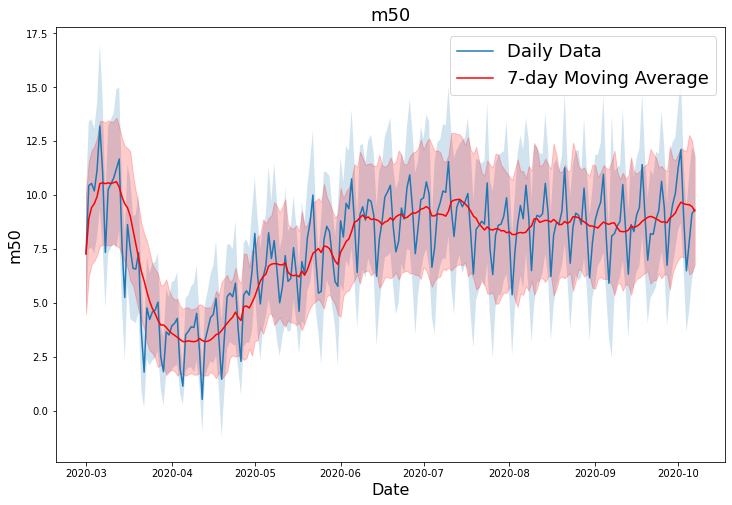

In [20]:
var = 'm50'
data_analysis.plot_metric(df_mobility,var,rolling_mean=True,df_mob_rm=df_mobility_rm)

<AxesSubplot:>

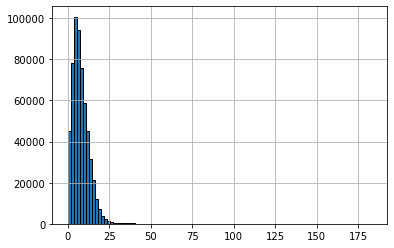

In [26]:
df_mobility_rm['m50'].hist(bins=100)

In [30]:
df_mob_rm_train = df_mobility_rm[df_mobility_rm['m50']<100]
target_cols = ['m50']#,'rm_mobility_per_trip','rm_Number of Trips']
covid_date = datetime.datetime.strptime('2020-03-15', '%Y-%m-%d')
end_date = datetime.datetime.strptime('2020-09-30', '%Y-%m-%d')
window = covid_date -datetime.timedelta(days=14)
df_post_covid= df_mob_rm_train[(df_mob_rm_train.date>=covid_date) & (df_mob_rm_train.date<=end_date)]
df_pre = df_mob_rm_train[(df_mob_rm_train.date<covid_date) & (df_mob_rm_train.date>window)]
df_pre_mean = df_pre.groupby(['fips','date'])[target_cols].mean()

pre_covid_mean = df_pre_mean.groupby(level=[0])[target_cols].mean()
df_covid_mean = df_post_covid.groupby(['fips','date'])[target_cols].mean()


post_covid_min_date = df_covid_mean.groupby(level=[0])[target_cols].idxmin()
for col in target_cols:
    rename_col = 'min_date_' + col
    post_covid_min_date['min_date_'+col] = post_covid_min_date[col].str[1]
    post_covid_min_date = post_covid_min_date.drop(columns=[col])
post_covid_min = df_covid_mean.groupby(level=[0])[target_cols].min()
for col in target_cols:
    post_covid_min = post_covid_min.rename(columns={col:'Min_'+col})
df_mob_red = pd.concat([pre_covid_mean,post_covid_min,post_covid_min_date],axis=1)

df_mob_red = df_mob_red.reset_index()
df_mob_red = df_mob_red.rename(columns={'index':'fips'})
for col in target_cols:
    min_date_col = 'min_date_' + col
    
    df_mob_red['Drop_days_'+col] = (df_mob_red[min_date_col] - covid_date).dt.days
    if col!='spend_all':
        df_mob_red['Norm_Drop_Rate_'+col] = ((df_mob_red[col] -df_mob_red['Min_'+col])/df_mob_red['Drop_days_'+col])/df_mob_red[col]
        df_mob_red['Pct_Red_'+col] =( df_mob_red[col] - df_mob_red['Min_'+col])/df_mob_red[col]
    else:
        df_mob_red['Norm_Drop_Rate_'+col] = ((-1*df_mob_red['Min_'+col])/df_mob_red['Drop_days_'+col])
        df_mob_red['Pct_Red_'+col] = -1*df_mob_red['Min_'+col]
df_mob_red = df_mob_red[df_mob_red['Pct_Red_m50']>=0]
def get_county_state(val_dict,x):
    return val_dict[x]

df_county_geocodes = pd.read_csv('./Data/County_GEOCODES-v2017.csv',encoding='latin')
df_county_geocodes['fips'] = df_county_geocodes['fips'].astype(str).str.zfill(5)
county_dict = df_county_geocodes.set_index('fips')['long_name'].to_dict()
df_mob_red['loc'] = df_mob_red['fips'].apply(lambda x: get_county_state(county_dict,x))
df_mob_red.sample(5)

,fips,m50,Min_m50,min_date_m50,Drop_days_m50,Norm_Drop_Rate_m50,Pct_Red_m50,loc
2017,45077,9.551500,4.245000,2020-04-13,29,0.019157,0.555567,Pickens County SC
1879,40151,3.198166,1.790429,2020-04-08,24,0.018340,0.440170,Woods County OK
152,05133,9.216701,3.847286,2020-04-05,21,0.027742,0.582575,Sevier County AR
225,08035,8.854696,0.231429,2020-04-02,18,0.054104,0.973864,Douglas County CO
337,13003,18.213605,9.132286,2020-04-09,25,0.019944,0.498601,Atkinson County GA


In [31]:
def plot_metric(df, col,name):
    plt.figure(figsize=(10,8))
    plt.rcParams["patch.force_edgecolor"] = True

    df[col].hist(bins = 100)
    plt.xlabel(name, fontsize=16)
    plt.ylabel('Count', fontsize = 16)

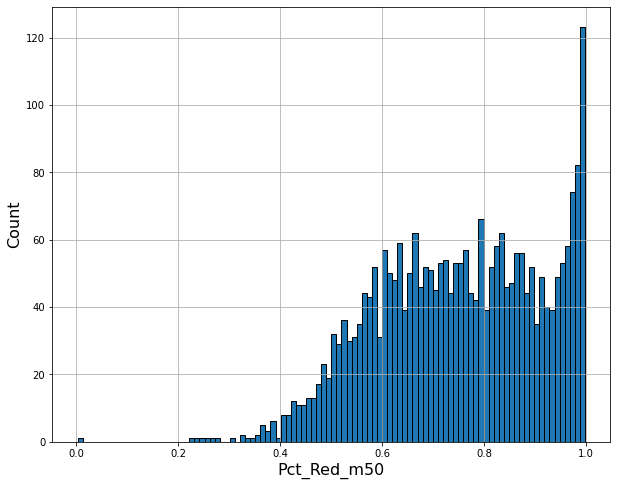

In [32]:
for metric in target_cols:
    plot_metric(df_mob_red,'Pct_Red_'+ metric,'Pct_Red_'+ metric)

In [33]:
cols = [col for col in df_mob_red.columns if 'm50' in col]

data_analysis.plot_map(col_list=cols,df=df_mob_red,save_op=False)